### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
from chart_studio import plotly
import plotly.figure_factory as ff

In [5]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

In [6]:
gov_arch_csv = 'data/communities_data_prepped.csv'

In [7]:
gov_df = pd.read_csv(gov_arch_csv)

In [8]:
gov_df.head()

,Name,Institutions,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Metanotes,Heterogeneity,FC comments,expert check,mechanisms_include_negotiation,mechanisms_include_meritocracy,mechanisms_include_suspension_expulsion_ostracism_proscription,mechanisms_include_secret_ballot,mechanisms_include_age_boundaries,mechanisms_include_vote_by_proxy,mechanisms_include_voting,mechanisms_include_mandate,mechanisms_include_lobbying,mechanisms_include_blood_relations,mechanisms_include_fines,mechanisms_include_representation,mechanisms_include_consensus,mechanisms_include_criticism_mocking_joking,mechanisms_include_magistrate_official,mechanisms_include_word_of_mouth,mechanisms_include_consultation,mechanisms_include_checks_and_balances,mechanisms_include_corporal_punishment_violence_against_perpetrator,mechanisms_include_life_appointment,mechanisms_include_forced_labour,mechanisms_include_council_central_,mechanisms_include_co-optation,mechanisms_include_paying_damages_compensation,mechanisms_include_unanimity,mechanisms_include_kingchief-as-figurehead,mechanisms_include_deliberation,mechanisms_include_seizing_of_property,mechanisms_include_autocratic_leader_chief_bound,mechanisms_include_plurality_voting,mechanisms_include_leader_first_among_equals,mechanisms_include_monitoring,mechanisms_include_reputational_risk,mechanisms_include_appeal,mechanisms_include_power_fluidity,mechanisms_include_graduated_sanctions,mechanisms_include_petition,mechanisms_include_delegation,mechanisms_include_vote_by_show_of_hands,mechanisms_include_temporary_position_of_power_term_limits,mechanisms_include_patronage_for_office,mechanisms_include_self-help,mechanisms_include_ratification_acclamation_only,mechanisms_include_rule_of_law,mechanisms_include_civil_disobedience,mechanisms_include_assembly_central,mechanisms_include_supermajority,mechanisms_include_military_force,mechanisms_include_arbitration,mechanisms_include_handshake,mechanisms_include_heredity,mechanisms_include_lottery_random_selection,mechanisms_include_matriarchy,mechanisms_include_bureaucracy,mechanisms_include_majority_voting,mechanisms_include_police,mechanisms_include_alliance,mechanisms_include_exit,mechanisms_include_board_committee,mechanisms_include_screening_process,mechanisms_include_jury_judge,mechanisms_include_dual-sex_political_system,mechanisms_include_remunerated_position,mechanisms_include_capital_punishment,mechanisms_include_mediation,mechanisms_include_public_meetings,mechanisms_include_balance_of_power,mechanisms_include_consent,mechanisms_include_property_requirement,mechanisms_include_destruction_of_property,mechanisms_include_turnover_rotation,mechanisms_include_litigation,mechanisms_include_quorum,mechanisms_include_tribunal_court_,mechanisms_include_frequent_and_or_regular_meetings,mechanisms_include_confederacy,mechanisms_include_assembly_local,mechanisms_include_council_local,mechanisms_include_judicial_review,mechanisms_include_induction_rite_ceremony,mechanisms_include_matrilineality,mechanisms_include_enfranchisement,mechanisms_include_popularity_,mechanisms_include_divine_right,mechanisms_include_payment_for_occupying_office,mechanisms_include_gerontocracy,mechanisms_include_oath,mechanisms_include_constitution,mechanisms_include_president_consul_chief_executive,mechanisms_include_veto,mechanisms_include_autocratic_leader_unbound,mechanisms_include_scrutiny_of_officials,mechanisms_include_open_political_unit,mechanisms_include_assembly_elite,mechanisms_include_agenda_setting,mechanisms_include_election,mechanisms_include_group_voting,mechanisms_include_coalition,mechanisms_include_dreaming,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown,Geography: Africa South,Geography: Europe North,Geography: Asia Southeast,Geography: Europe West,Geography: Middle East,"Geography: Europe Southeast, Anatolia",Geogr

# Normalized Correlation Matrix

In [9]:
data_plot = gov_df.select_dtypes(include=[np.number]).dropna()

In [10]:
data_plot.describe()

,Time span: Start,Time span: End,mechanisms_include_negotiation,mechanisms_include_meritocracy,mechanisms_include_suspension_expulsion_ostracism_proscription,mechanisms_include_secret_ballot,mechanisms_include_age_boundaries,mechanisms_include_vote_by_proxy,mechanisms_include_voting,mechanisms_include_mandate,mechanisms_include_lobbying,mechanisms_include_blood_relations,mechanisms_include_fines,mechanisms_include_representation,mechanisms_include_consensus,mechanisms_include_criticism_mocking_joking,mechanisms_include_magistrate_official,mechanisms_include_word_of_mouth,mechanisms_include_consultation,mechanisms_include_checks_and_balances,mechanisms_include_corporal_punishment_violence_against_perpetrator,mechanisms_include_life_appointment,mechanisms_include_forced_labour,mechanisms_include_council_central_,mechanisms_include_co-optation,mechanisms_include_paying_damages_compensation,mechanisms_include_unanimity,mechanisms_include_kingchief-as-figurehead,mechanisms_include_deliberation,mechanisms_include_seizing_of_property,mechanisms_include_autocratic_leader_chief_bound,mechanisms_include_plurality_voting,mechanisms_include_leader_first_among_equals,mechanisms_include_monitoring,mechanisms_include_reputational_risk,mechanisms_include_appeal,mechanisms_include_power_fluidity,mechanisms_include_graduated_sanctions,mechanisms_include_petition,mechanisms_include_delegation,mechanisms_include_vote_by_show_of_hands,mechanisms_include_temporary_position_of_power_term_limits,mechanisms_include_patronage_for_office,mechanisms_include_self-help,mechanisms_include_ratification_acclamation_only,mechanisms_include_rule_of_law,mechanisms_include_civil_disobedience,mechanisms_include_assembly_central,mechanisms_include_supermajority,mechanisms_include_military_force,mechanisms_include_arbitration,mechanisms_include_handshake,mechanisms_include_heredity,mechanisms_include_lottery_random_selection,mechanisms_include_matriarchy,mechanisms_include_bureaucracy,mechanisms_include_majority_voting,mechanisms_include_police,mechanisms_include_alliance,mechanisms_include_exit,mechanisms_include_board_committee,mechanisms_include_screening_process,mechanisms_include_jury_judge,mechanisms_include_dual-sex_political_system,mechanisms_include_remunerated_position,mechanisms_include_capital_punishment,mechanisms_include_mediation,mechanisms_include_public_meetings,mechanisms_include_balance_of_power,mechanisms_include_consent,mechanisms_include_property_requirement,mechanisms_include_destruction_of_property,mechanisms_include_turnover_rotation,mechanisms_include_litigation,mechanisms_include_quorum,mechanisms_include_tribunal_court_,mechanisms_include_frequent_and_or_regular_meetings,mechanisms_include_confederacy,mechanisms_include_assembly_local,mechanisms_include_council_local,mechanisms_include_judicial_review,mechanisms_include_induction_rite_ceremony,mechanisms_include_matrilineality,mechanisms_include_enfranchisement,mechanisms_include_popularity_,mechanisms_include_divine_right,mechanisms_include_payment_for_occupying_office,mechanisms_include_gerontocracy,mechanisms_include_oath,mechanisms_include_constitution,mechanisms_include_president_consul_chief_executive,mechanisms_include_veto,mechanisms_include_autocratic_leader_unbound,mechanisms_include_scrutiny_of_officials,mechanisms_include_open_political_unit,mechanisms_include_assembly_elite,mechanisms_include_agenda_setting,mechanisms_include_election,mechanisms_include_group_voting,mechanisms_include_coalition,mechanisms_include_dreaming,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown,Geography: Africa South,Geography: Europe North,Geography: Asia Southeast,Geography: Europe West,Geography: Middle East,"Geography: Europe Southeast, Anatolia",Geography: Europe South,"Geography: Central America, Mexico","Geography: Middle East, Mesopotamia, Babylonia",Geography: Africa North,Geograp

In [11]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,mechanisms_include_negotiation,mechanisms_include_meritocracy,mechanisms_include_suspension_expulsion_ostracism_proscription,mechanisms_include_secret_ballot,mechanisms_include_age_boundaries,mechanisms_include_vote_by_proxy,mechanisms_include_voting,mechanisms_include_mandate,mechanisms_include_lobbying,mechanisms_include_blood_relations,mechanisms_include_fines,mechanisms_include_representation,mechanisms_include_consensus,mechanisms_include_criticism_mocking_joking,mechanisms_include_magistrate_official,mechanisms_include_word_of_mouth,mechanisms_include_consultation,mechanisms_include_checks_and_balances,mechanisms_include_corporal_punishment_violence_against_perpetrator,mechanisms_include_life_appointment,mechanisms_include_forced_labour,mechanisms_include_council_central_,mechanisms_include_co-optation,mechanisms_include_paying_damages_compensation,mechanisms_include_unanimity,mechanisms_include_kingchief-as-figurehead,mechanisms_include_deliberation,mechanisms_include_seizing_of_property,mechanisms_include_autocratic_leader_chief_bound,mechanisms_include_plurality_voting,mechanisms_include_leader_first_among_equals,mechanisms_include_monitoring,mechanisms_include_reputational_risk,mechanisms_include_appeal,mechanisms_include_power_fluidity,mechanisms_include_graduated_sanctions,mechanisms_include_petition,mechanisms_include_delegation,mechanisms_include_vote_by_show_of_hands,mechanisms_include_temporary_position_of_power_term_limits,mechanisms_include_patronage_for_office,mechanisms_include_self-help,mechanisms_include_ratification_acclamation_only,mechanisms_include_rule_of_law,mechanisms_include_civil_disobedience,mechanisms_include_assembly_central,mechanisms_include_supermajority,mechanisms_include_military_force,mechanisms_include_arbitration,mechanisms_include_handshake,mechanisms_include_heredity,mechanisms_include_lottery_random_selection,mechanisms_include_matriarchy,mechanisms_include_bureaucracy,mechanisms_include_majority_voting,mechanisms_include_police,mechanisms_include_alliance,mechanisms_include_exit,mechanisms_include_board_committee,mechanisms_include_screening_process,mechanisms_include_jury_judge,mechanisms_include_dual-sex_political_system,mechanisms_include_remunerated_position,mechanisms_include_capital_punishment,mechanisms_include_mediation,mechanisms_include_public_meetings,mechanisms_include_balance_of_power,mechanisms_include_consent,mechanisms_include_property_requirement,mechanisms_include_destruction_of_property,mechanisms_include_turnover_rotation,mechanisms_include_litigation,mechanisms_include_quorum,mechanisms_include_tribunal_court_,mechanisms_include_frequent_and_or_regular_meetings,mechanisms_include_confederacy,mechanisms_include_assembly_local,mechanisms_include_council_local,mechanisms_include_judicial_review,mechanisms_include_induction_rite_ceremony,mechanisms_include_matrilineality,mechanisms_include_enfranchisement,mechanisms_include_popularity_,mechanisms_include_divine_right,mechanisms_include_payment_for_occupying_office,mechanisms_include_gerontocracy,mechanisms_include_oath,mechanisms_include_constitution,mechanisms_include_president_consul_chief_executive,mechanisms_include_veto,mechanisms_include_autocratic_leader_unbound,mechanisms_include_scrutiny_of_officials,mechanisms_include_open_political_unit,mechanisms_include_assembly_elite,mechanisms_include_agenda_setting,mechanisms_include_election,mechanisms_include_group_voting,mechanisms_include_coalition,mechanisms_include_dreaming,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown,Geography: Africa South,Geography: Europe North,Geography: Asia Southeast,Geography: Europe West,Geography: Middle East,"Geography: Europe Southeast, Anatolia",Geography: Europe South,"Geography: Central America, Mexico","Geography: Middle East, Mesopotamia, Babylonia",Geography: Africa North,Geograp

## Sort all correlations 

In [12]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [13]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr[0:n]

In [14]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

mechanisms_include_military_force                                    Geography: Asia, China                                                 1.000000
mechanisms_include_word_of_mouth                                     Geography: Africa West, Mid-western Nigeria                            1.000000
mechanisms_include_power_fluidity                                    Region: South America                                                  1.000000
mechanisms_include_graduated_sanctions                               Size: 100 - 1,000                                                      1.000000
mechanisms_include_petition                                          Geography: Africa North                                                1.000000
mechanisms_include_life_appointment                                  mechanisms_include_confederacy                                         1.000000
mechanisms_include_payment_for_occupying_office                      Geography: Africa Central            

In [15]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('positive_correlations.csv')

In [16]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start                                                Time span: Duration                                                   -0.616435
                                                                mechanisms_include_assembly_central                                   -0.523041
                                                                mechanisms_include_magistrate_official                                -0.483865
                                                                mechanisms_include_council_central_                                   -0.463056
                                                                Region: Europe                                                        -0.418325
Time span: End                                                  mechanisms_include_assembly_central                                   -0.386994
                                                                mechanisms_include_magistrate_official                                -0

In [17]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('negative_correlations.csv')

# Mechanisms

In [18]:
mechanisms_list = [x for x in gov_df.columns if x.startswith('mechanisms')]
mechanisms_list

['mechanisms_include_negotiation',
 'mechanisms_include_meritocracy',
 'mechanisms_include_suspension_expulsion_ostracism_proscription',
 'mechanisms_include_secret_ballot',
 'mechanisms_include_age_boundaries',
 'mechanisms_include_vote_by_proxy',
 'mechanisms_include_voting',
 'mechanisms_include_mandate',
 'mechanisms_include_lobbying',
 'mechanisms_include_blood_relations',
 'mechanisms_include_fines',
 'mechanisms_include_representation',
 'mechanisms_include_consensus',
 'mechanisms_include_criticism_mocking_joking',
 'mechanisms_include_magistrate_official',
 'mechanisms_include_word_of_mouth',
 'mechanisms_include_consultation',
 'mechanisms_include_checks_and_balances',
 'mechanisms_include_corporal_punishment_violence_against_perpetrator',
 'mechanisms_include_life_appointment',
 'mechanisms_include_forced_labour',
 'mechanisms_include_council_central_',
 'mechanisms_include_co-optation',
 'mechanisms_include_paying_damages_compensation',
 'mechanisms_include_unanimity',
 'me

In [19]:
# mechanisms_df = gov_df[['Name'] + mechanisms_list]
mechanisms_df = gov_df[mechanisms_list]

In [20]:
mechanisms_df

,mechanisms_include_negotiation,mechanisms_include_meritocracy,mechanisms_include_suspension_expulsion_ostracism_proscription,mechanisms_include_secret_ballot,mechanisms_include_age_boundaries,mechanisms_include_vote_by_proxy,mechanisms_include_voting,mechanisms_include_mandate,mechanisms_include_lobbying,mechanisms_include_blood_relations,mechanisms_include_fines,mechanisms_include_representation,mechanisms_include_consensus,mechanisms_include_criticism_mocking_joking,mechanisms_include_magistrate_official,mechanisms_include_word_of_mouth,mechanisms_include_consultation,mechanisms_include_checks_and_balances,mechanisms_include_corporal_punishment_violence_against_perpetrator,mechanisms_include_life_appointment,mechanisms_include_forced_labour,mechanisms_include_council_central_,mechanisms_include_co-optation,mechanisms_include_paying_damages_compensation,mechanisms_include_unanimity,mechanisms_include_kingchief-as-figurehead,mechanisms_include_deliberation,mechanisms_include_seizing_of_property,mechanisms_include_autocratic_leader_chief_bound,mechanisms_include_plurality_voting,mechanisms_include_leader_first_among_equals,mechanisms_include_monitoring,mechanisms_include_reputational_risk,mechanisms_include_appeal,mechanisms_include_power_fluidity,mechanisms_include_graduated_sanctions,mechanisms_include_petition,mechanisms_include_delegation,mechanisms_include_vote_by_show_of_hands,mechanisms_include_temporary_position_of_power_term_limits,mechanisms_include_patronage_for_office,mechanisms_include_self-help,mechanisms_include_ratification_acclamation_only,mechanisms_include_rule_of_law,mechanisms_include_civil_disobedience,mechanisms_include_assembly_central,mechanisms_include_supermajority,mechanisms_include_military_force,mechanisms_include_arbitration,mechanisms_include_handshake,mechanisms_include_heredity,mechanisms_include_lottery_random_selection,mechanisms_include_matriarchy,mechanisms_include_bureaucracy,mechanisms_include_majority_voting,mechanisms_include_police,mechanisms_include_alliance,mechanisms_include_exit,mechanisms_include_board_committee,mechanisms_include_screening_process,mechanisms_include_jury_judge,mechanisms_include_dual-sex_political_system,mechanisms_include_remunerated_position,mechanisms_include_capital_punishment,mechanisms_include_mediation,mechanisms_include_public_meetings,mechanisms_include_balance_of_power,mechanisms_include_consent,mechanisms_include_property_requirement,mechanisms_include_destruction_of_property,mechanisms_include_turnover_rotation,mechanisms_include_litigation,mechanisms_include_quorum,mechanisms_include_tribunal_court_,mechanisms_include_frequent_and_or_regular_meetings,mechanisms_include_confederacy,mechanisms_include_assembly_local,mechanisms_include_council_local,mechanisms_include_judicial_review,mechanisms_include_induction_rite_ceremony,mechanisms_include_matrilineality,mechanisms_include_enfranchisement,mechanisms_include_popularity_,mechanisms_include_divine_right,mechanisms_include_payment_for_occupying_office,mechanisms_include_gerontocracy,mechanisms_include_oath,mechanisms_include_constitution,mechanisms_include_president_consul_chief_executive,mechanisms_include_veto,mechanisms_include_autocratic_leader_unbound,mechanisms_include_scrutiny_of_officials,mechanisms_include_open_political_unit,mechanisms_include_assembly_elite,mechanisms_include_agenda_setting,mechanisms_include_election,mechanisms_include_group_voting,mechanisms_include_coalition,mechanisms_include_dreaming
0,1,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
2,0,1,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,

In [21]:
mechanisms_df.dropna(how='any').corr()

,mechanisms_include_negotiation,mechanisms_include_meritocracy,mechanisms_include_suspension_expulsion_ostracism_proscription,mechanisms_include_secret_ballot,mechanisms_include_age_boundaries,mechanisms_include_vote_by_proxy,mechanisms_include_voting,mechanisms_include_mandate,mechanisms_include_lobbying,mechanisms_include_blood_relations,mechanisms_include_fines,mechanisms_include_representation,mechanisms_include_consensus,mechanisms_include_criticism_mocking_joking,mechanisms_include_magistrate_official,mechanisms_include_word_of_mouth,mechanisms_include_consultation,mechanisms_include_checks_and_balances,mechanisms_include_corporal_punishment_violence_against_perpetrator,mechanisms_include_life_appointment,mechanisms_include_forced_labour,mechanisms_include_council_central_,mechanisms_include_co-optation,mechanisms_include_paying_damages_compensation,mechanisms_include_unanimity,mechanisms_include_kingchief-as-figurehead,mechanisms_include_deliberation,mechanisms_include_seizing_of_property,mechanisms_include_autocratic_leader_chief_bound,mechanisms_include_plurality_voting,mechanisms_include_leader_first_among_equals,mechanisms_include_monitoring,mechanisms_include_reputational_risk,mechanisms_include_appeal,mechanisms_include_power_fluidity,mechanisms_include_graduated_sanctions,mechanisms_include_petition,mechanisms_include_delegation,mechanisms_include_vote_by_show_of_hands,mechanisms_include_temporary_position_of_power_term_limits,mechanisms_include_patronage_for_office,mechanisms_include_self-help,mechanisms_include_ratification_acclamation_only,mechanisms_include_rule_of_law,mechanisms_include_civil_disobedience,mechanisms_include_assembly_central,mechanisms_include_supermajority,mechanisms_include_military_force,mechanisms_include_arbitration,mechanisms_include_handshake,mechanisms_include_heredity,mechanisms_include_lottery_random_selection,mechanisms_include_matriarchy,mechanisms_include_bureaucracy,mechanisms_include_majority_voting,mechanisms_include_police,mechanisms_include_alliance,mechanisms_include_exit,mechanisms_include_board_committee,mechanisms_include_screening_process,mechanisms_include_jury_judge,mechanisms_include_dual-sex_political_system,mechanisms_include_remunerated_position,mechanisms_include_capital_punishment,mechanisms_include_mediation,mechanisms_include_public_meetings,mechanisms_include_balance_of_power,mechanisms_include_consent,mechanisms_include_property_requirement,mechanisms_include_destruction_of_property,mechanisms_include_turnover_rotation,mechanisms_include_litigation,mechanisms_include_quorum,mechanisms_include_tribunal_court_,mechanisms_include_frequent_and_or_regular_meetings,mechanisms_include_confederacy,mechanisms_include_assembly_local,mechanisms_include_council_local,mechanisms_include_judicial_review,mechanisms_include_induction_rite_ceremony,mechanisms_include_matrilineality,mechanisms_include_enfranchisement,mechanisms_include_popularity_,mechanisms_include_divine_right,mechanisms_include_payment_for_occupying_office,mechanisms_include_gerontocracy,mechanisms_include_oath,mechanisms_include_constitution,mechanisms_include_president_consul_chief_executive,mechanisms_include_veto,mechanisms_include_autocratic_leader_unbound,mechanisms_include_scrutiny_of_officials,mechanisms_include_open_political_unit,mechanisms_include_assembly_elite,mechanisms_include_agenda_setting,mechanisms_include_election,mechanisms_include_group_voting,mechanisms_include_coalition,mechanisms_include_dreaming
mechanisms_include_negotiation,1.000000,0.181568,0.312147,-0.027067,-0.027067,-0.021926,-0.049286,-0.015385,-0.015385,-5.847053e-02,-0.031505,-5.847053e-02,-0.073058,0.488325,-9.376145e-02,-0.015385,-5.547002e-02,-0.042723,3.922323e-01,-0.021926,-0.015385,-0.135873,-0.031505,-0.027067,-0.031505,-0.035511,0.195081,-0.031505,-0.078863,-0.027067,0.250443,-0.021926,0.433235,-0.031505,-0.015385,-0.015385,-0.015385,-0.035511,-0.027067,-0.067267,-0.021926,0.360098,-0.031505,-0.039223,-0.021926,-0

In [ ]:
plt.figure(figsize=(40,40))
sns.heatmap(mechanisms_df.corr(),
            cmap='BrBG')

<Axes: >

### Look at correlations for specific variables

In [ ]:
norm_corr['Time span: Duration'].sort_values(ascending=False)

In [ ]:
norm_corr['Time span: Duration'].sort_values(ascending=True)

In [ ]:
norm_corr['Region: Africa'].sort_values(ascending=False)

In [ ]:
norm_corr[['Region: Africa', 'Region: Oceania']]

In [ ]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=True)

In [ ]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=False)

In [ ]:
norm_corr['Region: Africa'].sort_values(ascending=False)

In [ ]:
mechanisms_corr_df = norm_corr[mechanisms_list]

In [ ]:
mechanisms_corr_df

,mechanisms_include_negotiation,mechanisms_include_meritocracy,mechanisms_include_suspension_expulsion_ostracism_proscription,mechanisms_include_secret_ballot,mechanisms_include_age_boundaries,mechanisms_include_vote_by_proxy,mechanisms_include_voting,mechanisms_include_mandate,mechanisms_include_lobbying,mechanisms_include_blood_relations,mechanisms_include_fines,mechanisms_include_representation,mechanisms_include_consensus,mechanisms_include_criticism_mocking_joking,mechanisms_include_magistrate_official,mechanisms_include_word_of_mouth,mechanisms_include_consultation,mechanisms_include_checks_and_balances,mechanisms_include_corporal_punishment_violence_against_perpetrator,mechanisms_include_life_appointment,mechanisms_include_forced_labour,mechanisms_include_council_central_,mechanisms_include_co-optation,mechanisms_include_paying_damages_compensation,mechanisms_include_unanimity,mechanisms_include_kingchief-as-figurehead,mechanisms_include_deliberation,mechanisms_include_seizing_of_property,mechanisms_include_autocratic_leader_chief_bound,mechanisms_include_plurality_voting,mechanisms_include_leader_first_among_equals,mechanisms_include_monitoring,mechanisms_include_reputational_risk,mechanisms_include_appeal,mechanisms_include_power_fluidity,mechanisms_include_graduated_sanctions,mechanisms_include_petition,mechanisms_include_delegation,mechanisms_include_vote_by_show_of_hands,mechanisms_include_temporary_position_of_power_term_limits,mechanisms_include_patronage_for_office,mechanisms_include_self-help,mechanisms_include_ratification_acclamation_only,mechanisms_include_rule_of_law,mechanisms_include_civil_disobedience,mechanisms_include_assembly_central,mechanisms_include_supermajority,mechanisms_include_military_force,mechanisms_include_arbitration,mechanisms_include_handshake,mechanisms_include_heredity,mechanisms_include_lottery_random_selection,mechanisms_include_matriarchy,mechanisms_include_bureaucracy,mechanisms_include_majority_voting,mechanisms_include_police,mechanisms_include_alliance,mechanisms_include_exit,mechanisms_include_board_committee,mechanisms_include_screening_process,mechanisms_include_jury_judge,mechanisms_include_dual-sex_political_system,mechanisms_include_remunerated_position,mechanisms_include_capital_punishment,mechanisms_include_mediation,mechanisms_include_public_meetings,mechanisms_include_balance_of_power,mechanisms_include_consent,mechanisms_include_property_requirement,mechanisms_include_destruction_of_property,mechanisms_include_turnover_rotation,mechanisms_include_litigation,mechanisms_include_quorum,mechanisms_include_tribunal_court_,mechanisms_include_frequent_and_or_regular_meetings,mechanisms_include_confederacy,mechanisms_include_assembly_local,mechanisms_include_council_local,mechanisms_include_judicial_review,mechanisms_include_induction_rite_ceremony,mechanisms_include_matrilineality,mechanisms_include_enfranchisement,mechanisms_include_popularity_,mechanisms_include_divine_right,mechanisms_include_payment_for_occupying_office,mechanisms_include_gerontocracy,mechanisms_include_oath,mechanisms_include_constitution,mechanisms_include_president_consul_chief_executive,mechanisms_include_veto,mechanisms_include_autocratic_leader_unbound,mechanisms_include_scrutiny_of_officials,mechanisms_include_open_political_unit,mechanisms_include_assembly_elite,mechanisms_include_agenda_setting,mechanisms_include_election,mechanisms_include_group_voting,mechanisms_include_coalition,mechanisms_include_dreaming
Time span: Start,0.095720,0.132913,-0.326171,-0.254623,-0.253842,0.125295,-0.179491,-0.198548,0.053191,-0.152065,-0.126015,0.223211,-0.139232,-0.123550,-0.483865,0.053191,-0.117754,-0.196736,-0.128502,0.113415,-0.183441,-0.463056,0.177581,-0.206304,-0.104583,0.209623,-0.096400,-0.121387,-0.306676,-0.142695,-0.036716,-0.164469,0.192272,-0.217542,0.096585,0.091922,-0.199680,-0.198135,-0.254623,-0.229780,0.124103,-0.046374,-0.243532,-0.281466,0.121307,-0.523041,0.108214,-0.196766,-0.090732,-0

In [ ]:
query_mechanisms_df = mechanisms_corr_df.transpose()

In [ ]:
query_mechanisms_df.head()

## Time x Mechanism

In [ ]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [ ]:
time_mechanisms = query_mechanisms_df[time_span_cols]
time_mechanisms

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(time_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()

# Region x Mechanism

In [ ]:
list(gov_df)

In [ ]:
region_cols = [r for r in list(gov_df) if 'Region: ' in r] 

In [ ]:
region_cols

In [ ]:
region_mechanisms = query_mechanisms_df[region_cols]
region_mechanisms

In [41]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

# Size x Mechanism

In [ ]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [ ]:
size_mechanisms = query_mechanisms_df[size_cols]

In [44]:
plt.figure(figsize=(40, 30))

sns.heatmap(size_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()

# Query and sort for mechanisms

In [ ]:
def query_mech(col_name, ascending=False):
    # Return a sorted frame for a single column
    return query_mechanisms_df[col_name].sort_values(ascending=ascending)

In [ ]:
query_mechanisms_df['Time span: Start'].sort_values(ascending=False)

In [ ]:
query_mech('Time span: Duration')

In [ ]:
query_mech('Time span: Duration', ascending=True)

In [49]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.show()
plt.savefig('triangle_corr.png')

<Figure size 1920x1440 with 0 Axes>

In [50]:
plt.figure(figsize=(20,50))

heatmap = sns.heatmap(
    norm_corr[['Time span: Duration']].dropna().sort_values(
        by='Time span: Duration', 
        ascending=False), 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    annot_kws={"size": 8},
    xticklabels=1, 
    yticklabels=1, 
    cmap='BrBG')

heatmap.set_title('Features Correlating with Time span: Duration', fontdict={'fontsize':18}, pad=16);

# Time x Region x Size

In [51]:
norm_corr[time_span_cols + region_cols + size_cols]

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.947680,-0.616435,-0.102745,-0.418325,0.057411,-0.338588,0.265503,0.142723,0.096585,0.096376,0.091922,-0.138404,-0.032763,-0.297985,-0.119669,-0.067615,-0.050603
Time span: End,0.947680,1.000000,-0.332825,-0.044050,-0.288202,0.044345,-0.328927,0.217801,0.167875,0.067786,0.068000,0.072159,-0.157328,0.022554,-0.214449,-0.025501,-0.042983,-0.004247
mechanisms_include_negotiation,0.095720,0.068659,-0.113400,0.127574,-0.066750,-0.056418,-0.035319,-0.045962,-0.031186,-0.015385,-0.015385,-0.015385,0.123021,-0.087105,-0.033482,-0.033085,-0.028744,-0.032163
mechanisms_include_meritocracy,0.132913,0.133502,-0.063325,0.016608,-0.310720,0.386264,-0.127221,0.193992,0.195788,0.112596,-0.079317,-0.079317,-0.105055,-0.135711,-0.096112,-0.088341,0.439185,-0.114770
mechanisms_include_suspension_expulsion_ostracism_proscription,-0.326171,-0.264573,0.310907,0.465106,0.266824,-0.093546,-0.091320,-0.066895,-0.080634,0.073743,-0.039778,-0.039778,-0.084797,0.057262,0.371841,0.276627,-0.042908,-0.049186
mechanisms_include_secret_ballot,-0.254623,-0.229910,0.185057,-0.057923,0.350640,-0.088870,-0.055635,-0.072399,0.015734,-0.024234,-0.024234,-0.024234,-0.074897,0.248159,0.228697,-0.052115,-0.045277,-0.050664
mechanisms_include_age_boundaries,-0.253842,-0.231171,0.179639,-0.029979,0.337322,-0.088977,-0.055702,-0.072486,-0.049184,-0.024263,-0.024263,-0.024263,-0.045913,-0.137374,0.222285,0.496490,-0.045332,-0.050725
mechanisms_include_vote_by_proxy,0.125295,0.105934,-0.108821,-0.052304,-0.030848,0.067613,-0.050238,-0.065376,-0.044359,-0.021883,-0.021883,-0.021883,-0.067632,-0.035090,-0.047624,0.131452,-0.040885,-0.045749
mechanisms_include_voting,-0.179491,-0.181714,0.081995,-0.095405,0.288900,-0.146377,-0.091637,0.013559,0.035370,0.118273,-0.039915,-0.039915,-0.036101,-0.122125,0.191113,0.418835,-0.074576,-0.083448
mechanisms_include_mandate,-0.198548,-0.230860,0.017065,-0.036772,-0.066750,-0.056418,0.558627,-0.045962,-0.031186,-0.015385,-0.015385,-0.015385,-0.047548,0.242376,-0.033482,-0.033085,-0.028744,-0.032163


In [52]:
time_region_size = norm_corr[time_span_cols + region_cols + size_cols].loc[time_span_cols + region_cols + size_cols]

In [53]:
time_region_size

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.947680,-0.616435,-0.102745,-0.418325,0.057411,-0.338588,0.265503,0.142723,0.096585,0.096376,0.091922,-0.138404,-0.032763,-0.297985,-0.119669,-0.067615,-0.050603
Time span: End,0.947680,1.000000,-0.332825,-0.044050,-0.288202,0.044345,-0.328927,0.217801,0.167875,0.067786,0.068000,0.072159,-0.157328,0.022554,-0.214449,-0.025501,-0.042983,-0.004247
Time span: Duration,-0.616435,-0.332825,1.000000,0.194856,0.524848,-0.060212,0.188850,-0.247063,-0.007519,-0.118110,-0.116966,-0.093548,0.020776,0.152415,0.351284,0.290601,0.093713,0.139007
Region: Africa,-0.102745,-0.044050,0.194856,1.000000,-0.159543,-0.134848,-0.084419,-0.109856,-0.074541,-0.036772,-0.036772,-0.036772,-0.058078,-0.069981,0.323299,0.015113,-0.068703,-0.076876
Region: Europe,-0.418325,-0.288202,0.524848,-0.159543,1.000000,-0.244782,-0.153241,-0.199414,-0.135309,-0.066750,-0.066750,-0.066750,0.199186,0.215455,0.573118,0.180773,-0.124712,-0.068514
Region: Asia,0.057411,0.044345,-0.060212,-0.134848,-0.244782,1.000000,-0.129523,-0.168549,-0.114366,-0.056418,-0.056418,-0.056418,-0.174366,-0.174697,-0.122783,-0.070065,0.720614,0.074908
Region: Middle East,-0.338588,-0.328927,0.188850,-0.084419,-0.153241,-0.129523,1.000000,-0.105517,-0.071597,-0.035319,-0.035319,-0.035319,-0.109159,0.053750,-0.039101,-0.075955,-0.065989,0.432122
Region: North America,0.265503,0.217801,-0.247063,-0.109856,-0.199414,-0.168549,-0.105517,1.000000,-0.093169,-0.045962,-0.045962,0.313371,0.124512,-0.061727,-0.100027,-0.098841,-0.085872,-0.096088
Region: Central America,0.142723,0.167875,-0.007519,-0.074541,-0.135309,-0.114366,-0.071597,-0.093169,1.000000,-0.031186,-0.031186,-0.031186,-0.096385,-0.176572,0.160255,-0.067066,-0.058267,-0.065198
Region: South America,0.096585,0.067786,-0.118110,-0.036772,-0.066750,-0.056418,-0.035319,-0.045962,-0.031186,1.000000,-0.015385,-0.015385,0.124111,-0.087105,-0.033482,-0.033085,-0.028744,-0.032163


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_99564/2730578262.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))


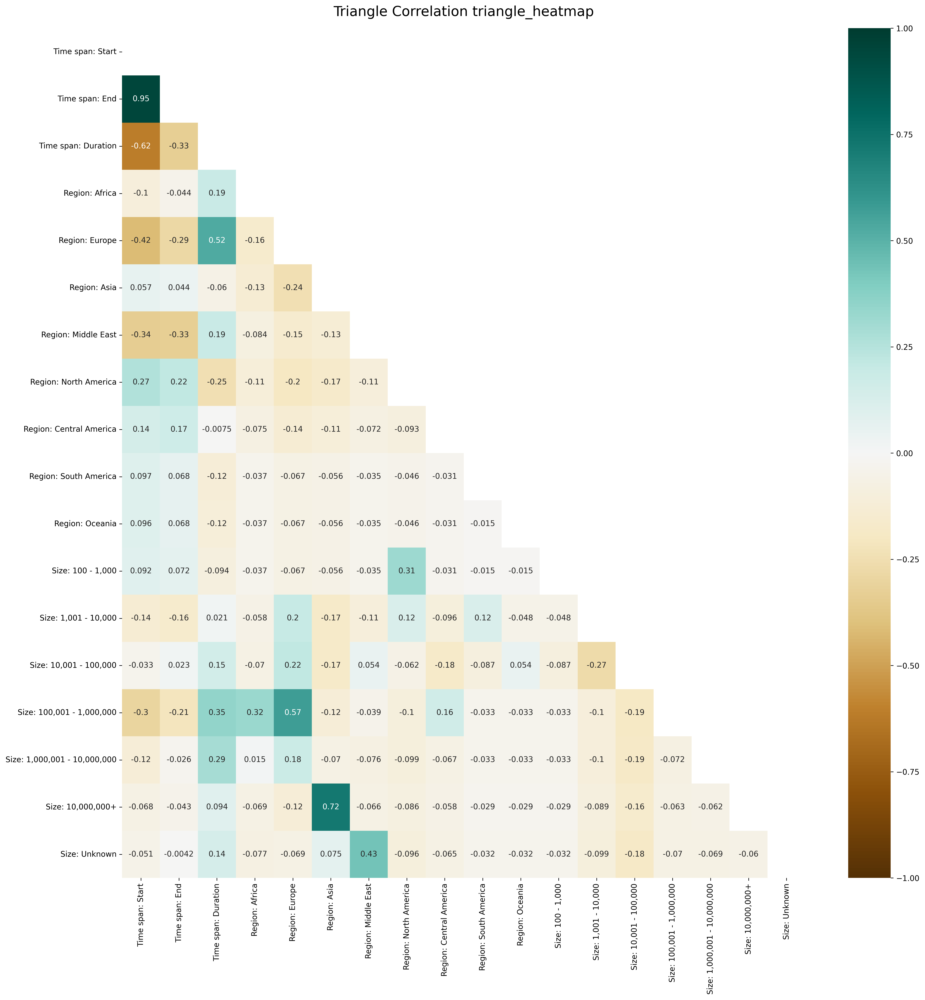

<Figure size 1920x1440 with 0 Axes>

In [54]:
plt.figure(figsize=(20, 20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    time_region_size, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.show()
plt.savefig('time_region_size.png')

## Time

In [55]:
time_corr = norm_corr[time_span_cols].loc[region_cols + size_cols]

In [56]:
time_corr

,Time span: Start,Time span: End,Time span: Duration
Region: Africa,-0.102745,-0.044050,0.194856
Region: Europe,-0.418325,-0.288202,0.524848
Region: Asia,0.057411,0.044345,-0.060212
Region: Middle East,-0.338588,-0.328927,0.188850
Region: North America,0.265503,0.217801,-0.247063
Region: Central America,0.142723,0.167875,-0.007519
Region: South America,0.096585,0.067786,-0.118110
Region: Oceania,0.096376,0.068000,-0.116966
"Size: 100 - 1,000",0.091922,0.072159,-0.093548
"Size: 1,001 - 10,000",-0.138404,-0.157328,0.020776


<Axes: >

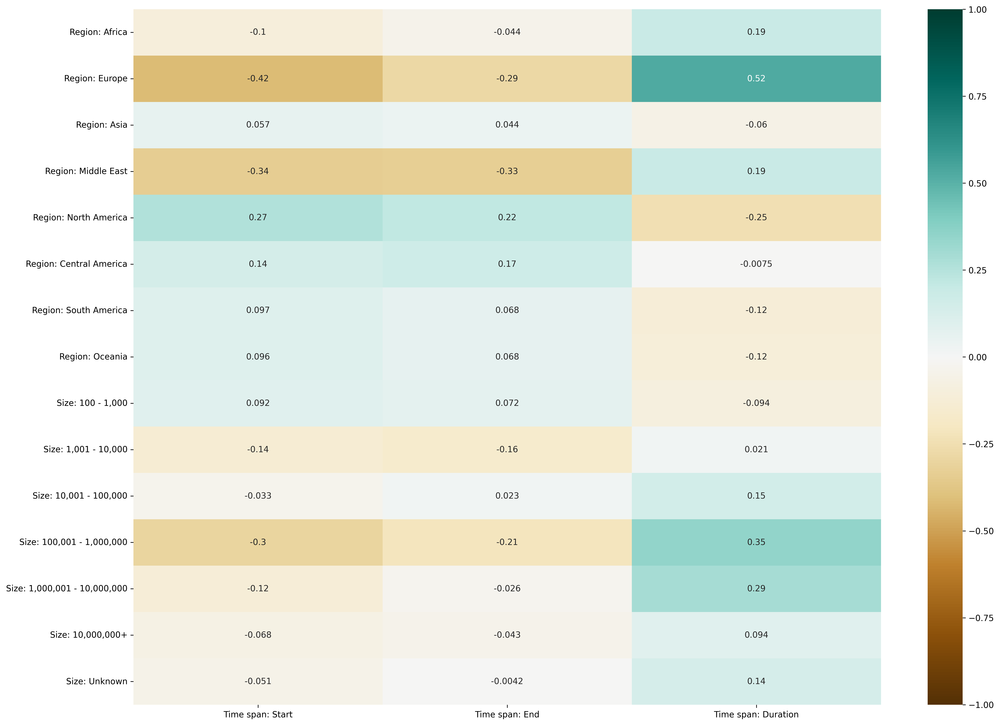

In [57]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

## Region

In [58]:
region_corr = norm_corr[region_cols].loc[time_span_cols + size_cols]

<Axes: >

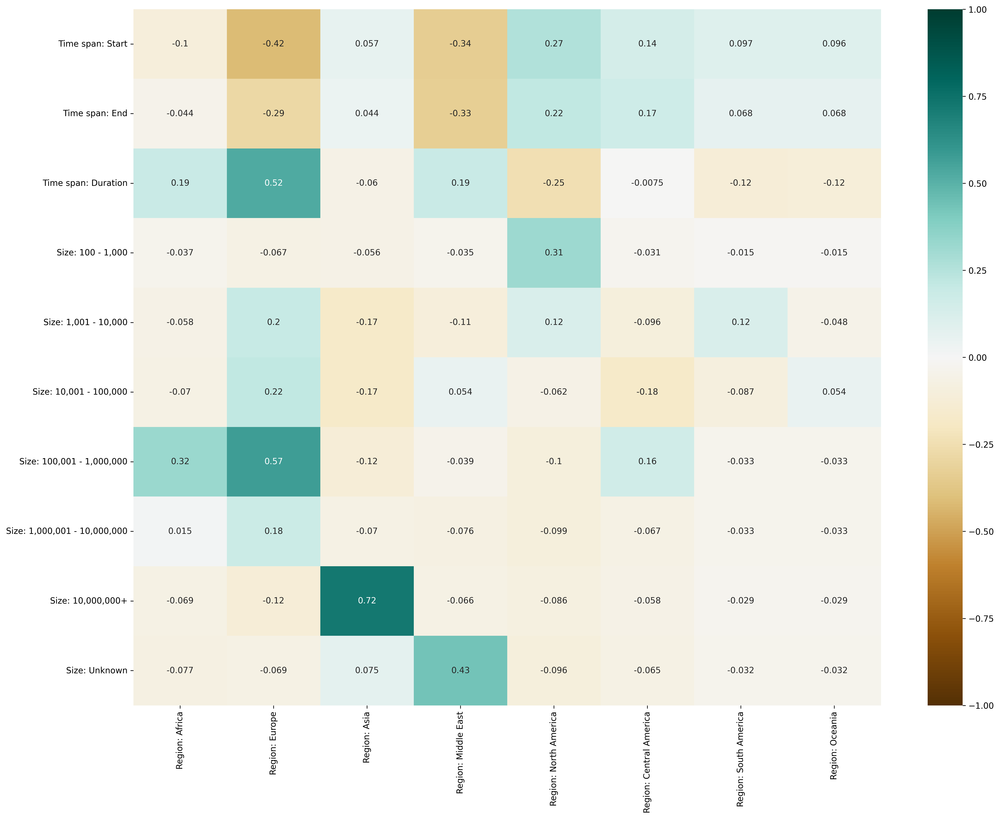

In [59]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

## Size 

In [60]:
size_corr = norm_corr[size_cols].loc[time_span_cols + region_cols]

<Axes: >

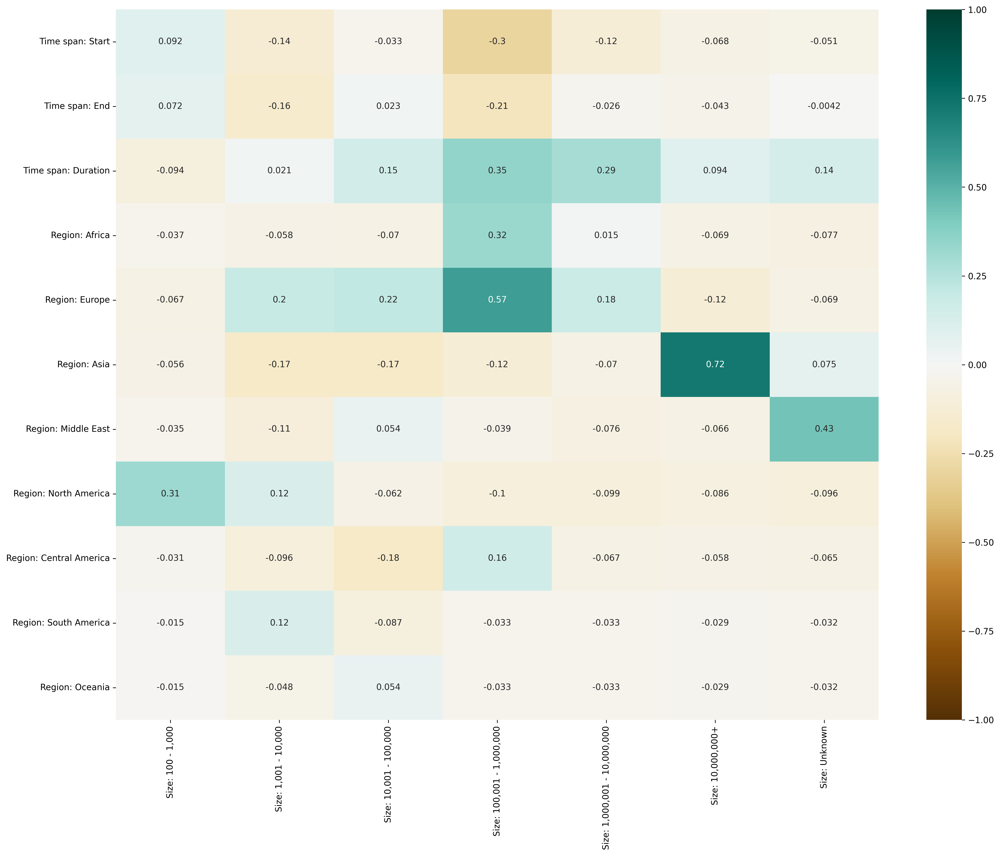

In [61]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)